# Vacant Lots as Sites for Insurgent Strategies Toward Healing

##   Group: LandAccess4All
Lupe Rentreria Salome and Mel Liu

### How did both of us decide to map land in Los Angeles?

In 222A Histories and Theories of Planning, we learned about how research is often used to answer questions we already know the answers to. What both of us don't know the answer to is what are the possibilities for taking land back admidst housing shortages and privitazion, as well as goverment misuse of public lands. How could land exist outside colonial frameworks?

Urban planning is results from contestation of spaces and visions. Despite contenstation, how might be be able to hold space for collaoration and community? How many and what types of vacant lots exists?

We hope that making a map of vacant land parcels available to community members who are building people power through land trusts, and seeking rematriation efforts, can benefit from this information.

## Our Data

### [Vacant Parcels from the County Assessor](https://data.lacounty.gov/Parcel-/Vacant-Parcels-LA-County-from-ASR-Use-Code/vcaw-zeg9)

"Valuation and property description for parcels on the Assessor's annual secured assessment roll for 2015."

*The file was close to 75 mb, I reduced down to 39 mb by deleting empty or redundant columns first. I will refer to the above link for the metadata on the meaning of the other columns.

### [Vacant Land Data: Community Boundaries](https://data.lacounty.gov/GIS-Data/Community-Boundaries-CSA-/g4rb-en2z)

Communities are one of the most complex geographic issues in the County of Los Angeles, due to historical narratives, perceptions of value, intense public interest, and shifts over time. The County has a need to establish a consistent geographic reporting base that will enable statistics and information to reported to the Board, that attempts to represent all of the interactions but is primarily focused on reporting.

### [LA Zoning](https://data.lacity.org/A-Well-Run-City/LA-Zoning/8625-f7mv)

Zoning is a tool used by the City of Los Angeles to designate, regulate and restrict the location and use of buildings, structures and land, for agriculture, residence, commerce, trade, industry or other purposes; to regulate and limit the height, number of stories, and size of buildings and other structures hereafter erected or altered to regulate and determine the size of yards and other open spaces and to regulate and limit the density of population; and for said purposes to divide the City into zones of such number, shape and area as may be deemed best suited to carry out these regulations and provide for their enforcement. We will be using this data to overlay it with vacant lots by community neighborhood. 


In [2]:
# libraries
import urllib.request, json 
import pandas as pd
import geopandas as gpd
import contextily as ctx
import matplotlib.pyplot as plt
from sodapy import Socrata

/opt/conda/lib/python3.9/site-packages/geopandas/_compat.py:106: UserWarning: The Shapely GEOS version (3.9.1-CAPI-1.14.2) is incompatible with the GEOS version PyGEOS was compiled with (3.10.1-CAPI-1.16.0). Conversions between both will be slow.
  warnings.warn(


In [3]:
# connect to the data portal
client = Socrata("data.lacounty.gov", None)

# First 5000 results, returned as JSON from API / converted to Python list of
# dictionaries by sodapy.
results = client.get("vcaw-zeg9", limit=180000, where="taxratearea_city=='LOS ANGELES'")

# Convert to pandas DataFrame
vacdf = pd.DataFrame.from_records(results)

vacdf.sample(2)

,usecodedescchar1,roll_homeownersexemp,situsunit,recordingdate,effectiveyearbuilt,istaxableparcel,roll_totlandimp,roll_perspropexemp,parcelboundarydescription,roll_landbaseyear,...,location_1,bathrooms,sqftmain,situsdirection,roll_realestateexemp,center_lat,situszip,yearbuilt,propertylocation,situszip5
1492,Residential,0,,20131113,0,Y,137187,0,TR=72050 LOT 20,2014,...,"{'latitude': '34.20181764', 'needs_recoding': ...",0,0,,0,34.20181764,,0,NaN,NaN
14519,Industrial,0,,20131224,0,Y,10739,0,TR=5893*(EX OF STS) LOT 46,1980,...,"{'latitude': '34.02566679', 'needs_recoding': ...",0,0,,0,34.02566679,,0,NaN,NaN


In [5]:
vacdf.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 33091 entries, 0 to 33090
Data columns (total 51 columns):
 #   Column                     Non-Null Count  Dtype 
---  ------                     --------------  ----- 
 0   usecodedescchar1           33080 non-null  object
 1   roll_homeownersexemp       33091 non-null  object
 2   situsunit                  33091 non-null  object
 3   recordingdate              33091 non-null  object
 4   effectiveyearbuilt         33091 non-null  object
 5   istaxableparcel            33091 non-null  object
 6   roll_totlandimp            33091 non-null  object
 7   roll_perspropexemp         33091 non-null  object
 8   parcelboundarydescription  33091 non-null  object
 9   roll_landbaseyear          33091 non-null  object
 10  situscity                  33091 non-null  object
 11  roll_impbaseyear           33091 non-null  object
 12  usetype                    33080 non-null  object
 13  cluster                    33091 non-null  object
 14  adminr

In [6]:
# convert df to gdf for vacant parcels
# since data is in lat/lon's assign the crs to WGS84 (epsg:4326)
vacgdf = gpd.GeoDataFrame(vacdf, 
                       crs='epsg:4326',
                       geometry=gpd.points_from_xy(vacdf.center_lon, vacdf.center_lat))

In [7]:
# output the data's projection
vacgdf.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

### Mapping the Vacant Lots Data 

We will add a basemap to the vacant lots data

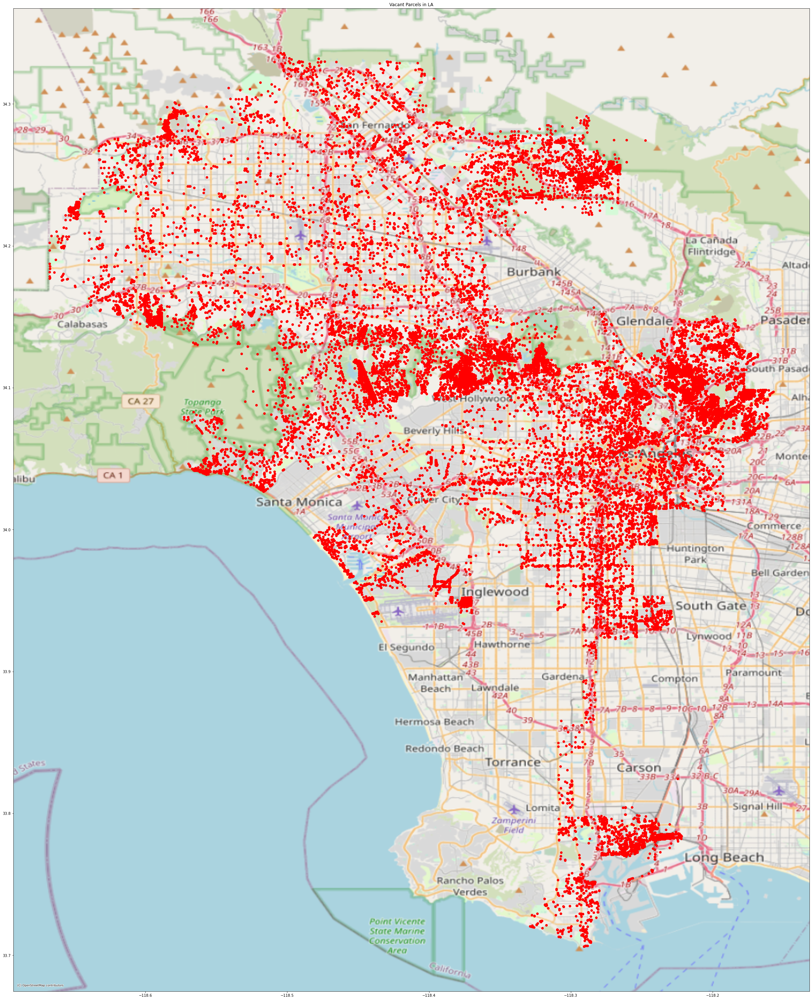

In [8]:

# reproject to web mercator - CHANGE to 4326 for our clean notebook
vacgdf_web_mercator = vacgdf.to_crs(epsg=4326)

# map the vacant parcels
fig, ax = plt.subplots(figsize=(50,50))

vacgdf_web_mercator.plot(ax=ax,
                      color='red')

ax.axis('on')

ax.set_title('Vacant Parcels in LA')

ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik, crs=vacgdf_web_mercator.crs)

### Adding Community Boundaries Data Set 
Now that we were able to see the number of vacant parcels in LA, beyond the thousand oaks valley from a few weeks ago, we want to plot it within each community.

In [9]:
#Time to import the community boundaries data set

comgdf = gpd.read_file("Community Boundaries (CSA) (1).geojson")

In [10]:
type (comgdf)

geopandas.geodataframe.GeoDataFrame

In [11]:
comgdf.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 348 entries, 0 to 347
Data columns (total 9 columns):
 #   Column          Non-Null Count  Dtype   
---  ------          --------------  -----   
 0   community       261 non-null    object  
 1   source          348 non-null    object  
 2   label           348 non-null    object  
 3   city_type       348 non-null    object  
 4   objectid        348 non-null    object  
 5   lcity           348 non-null    object  
 6   shape_stlength  348 non-null    object  
 7   shape_starea    348 non-null    object  
 8   geometry        348 non-null    geometry
dtypes: geometry(1), object(8)
memory usage: 24.6+ KB


In [12]:
list(comgdf)

['community',
 'source',
 'label',
 'city_type',
 'objectid',
 'lcity',
 'shape_stlength',
 'shape_starea',
 'geometry']

<AxesSubplot:>

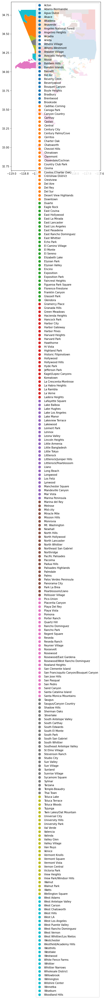

In [14]:
#let's map the community boundaries geodataframe- this will show us the number of communities in LA

comgdf.plot(figsize=(12,12),
                          column='community',
                          legend=True)

### Adding a basemap with vacant lots at large 

In [15]:
# now let's project to web mercator st the same projection as the vacant lot dataframe
comgdf_wm = comgdf.to_crs(epsg=4326)

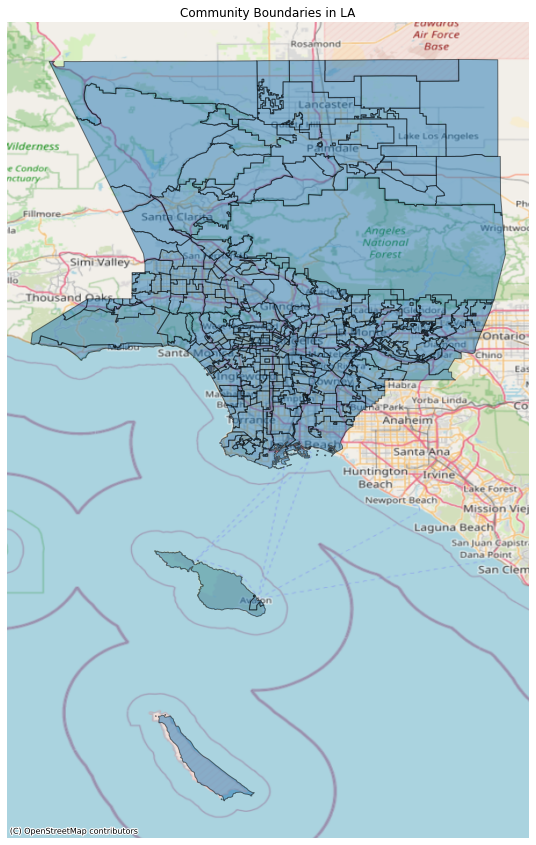

In [16]:
# Great, looks like it's all set, lets see how this plot looks like

ax = comgdf_wm.plot(figsize=(15, 15), alpha=0.5, edgecolor='k')


ax.axis('off')

ax.set_title('Community Boundaries in LA')

ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik, crs=vacgdf_web_mercator.crs)

This looks weird, seems like the vacant parcels are being plotted, however we do see the boundaries. Iwill have to come back to this or see if we can plot in an interactive map. 

### Spatial Join
we want to assign number of lots per neighborhood

In [19]:
# conduct a spatial join (i.e. assign each vacant lot to the neighborhood it is in)
vac_by_com = gpd.sjoin(comgdf, vacgdf) #Spatial join Points to polygons
vac_by_com


,community,source,label,city_type,objectid,lcity,shape_stlength,shape_starea,geometry,index_right,...,location_1,bathrooms,sqftmain,situsdirection,roll_realestateexemp,center_lat,situszip,yearbuilt,propertylocation,situszip5
2,Harvard Heights,LA City,Los Angeles - Harvard Heights,City,95,Los Angeles,21077.385705038188,20898421.74609375,"MULTIPOLYGON (((-118.29156 34.04000, -118.2923...",14851,...,"{'latitude': '34.04317632', 'needs_recoding': ...",0,0,,0,34.04317632,,0,NaN,NaN
2,Harvard Heights,LA City,Los Angeles - Harvard Heights,City,95,Los Angeles,21077.385705038188,20898421.74609375,"MULTIPOLYGON (((-118.29156 34.04000, -118.2923...",14814,...,"{'latitude': '34.04326202', 'needs_recoding': ...",0,0,,0,34.04326202,,0,NaN,NaN
2,Harvard Heights,LA City,Los Angeles - Harvard Heights,City,95,Los Angeles,21077.385705038188,20898421.74609375,"MULTIPOLYGON (((-118.29156 34.04000, -118.2923...",14850,...,"{'latitude': '34.0433412', 'needs_recoding': F...",0,0,,0,34.04334120,,0,NaN,NaN
2,Harvard Heights,LA City,Los Angeles - Harvard Heights,City,95,Los Angeles,21077.385705038188,20898421.74609375,"MULTIPOLYGON (((-118.29156 34.04000, -118.2923...",490,...,"{'latitude': '34.04679216', 'needs_recoding': ...",0,0,,0,34.04679216,,0,NaN,NaN
2,Harvard Heights,LA City,Los Angeles - Harvard Heights,City,95,Los Angeles,21077.385705038188,20898421.74609375,"MULTIPOLYGON (((-118.29156 34.04000, -118.2923...",14843,...,"{'latitude': '34.04688601', 'needs_recoding': ...",0,0,,0,34.04688601,90019-4552,0,1512 ARLINGTON AVE LOS ANGELES CA 90019,90019
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
346,West Hills,LA City,Los Angeles - West Hills,City,174,Los Angeles,105989.43541216178,278714351.12011719,"MULTIPOLYGON (((-118.60490 34.23545, -118.6045...",32038,...,"{'latitude': '34.23666915', 'needs_recoding': ...",0,0,,0,34.23666915,,0,NaN,NaN
346,West Hills,LA City,Los Angeles - West Hills,City,174,Los Angeles,105989.43541216178,278714351.12011719,"MULTIPOLYGON (((-118.60490 34.23545, -118.6045...",32041,...,"{'latitude': '34.23763845', 'needs_recoding': ...",0,0,,0,34.23763845,,0,NaN,NaN
346,West Hills,LA City,Los Angeles - West Hills,City,174,Los Angeles,105989.43541216178,278714351.12011719,"MULTIPOLYGON (((-118.60490 34.23545, -118.6045...",32055,...,"{'latitude': '34.23473438', 'needs_recoding': ...",0,0,,0,34.23473438,91304-1436,0,9039 TOPANGA CANYON BLVD LOS ANGELES CA 91304,91304
346,West Hills,LA City,Los Angeles - West Hills,City,174,Los Angeles,105989.43541216178,278714351.12011719,"MULTIPOLYGON (((-118.60490 34.23545, -118.6045...",32050,...,"{'latitude': '34.23480785', 'needs_recoding': ...",0,0,,0,34.23480785,,0,NaN,NaN


In [20]:
vac_count = vac_by_com.value_counts('community').reset_index(name='vac_count')
vac_count

,community,vac_count
0,Hollywood Hills,1954
1,Beverly Crest,1818
2,Hollywood,1519
3,Wilmington,1509
4,Mt. Washington,1467
...,...,...
137,Sycamore Square,2
138,Willowbrook,1
139,Universal City,1
140,Toluca Terrace,1


In [21]:
# add the count to the neighborhoods
comgdf = comgdf.merge(vac_count, how='left', on='community')

In [22]:
comgdf.sample(10)

,community,source,label,city_type,objectid,lcity,shape_stlength,shape_starea,geometry,vac_count
273,Charter Oak,BOS,Unincorporated - Charter Oak,Unincorporated,239,Unincorporated,4331.6046062540017,303618.1865234375,"MULTIPOLYGON (((-117.87199 34.06035, -117.8724...",NaN
248,Val Verde,BOS,Unincorporated - Val Verde,Unincorporated,323,Unincorporated,106228.80173672964,503715764.80664063,"MULTIPOLYGON (((-118.61320 34.44969, -118.6132...",NaN
83,None,BOS,City of Redondo Beach,City,198,Redondo Beach,116820.91322362145,173751369.73828125,"MULTIPOLYGON (((-118.36584 33.89462, -118.3612...",NaN
287,Lake Manor,BOS,Unincorporated - Lake Manor,Unincorporated,273,Unincorporated,28934.026117280846,15266439.71484375,"MULTIPOLYGON (((-118.63251 34.24039, -118.6325...",NaN
72,Koreatown,LA City,Los Angeles - Koreatown,City,103,Los Angeles,28508.355350344202,40641749.625976563,"MULTIPOLYGON (((-118.29162 34.05498, -118.2916...",109.0
263,West Chatsworth,BOS,Unincorporated - West Chatsworth,Unincorporated,329,Unincorporated,37452.270120405497,38586674.349609375,"MULTIPOLYGON (((-118.64775 34.23498, -118.6477...",NaN
343,None,BOS,City of Palos Verdes Estates,City,193,Palos Verdes Estates,70747.690778511373,133122354.91699219,"MULTIPOLYGON (((-118.35105 33.79521, -118.3553...",NaN
282,None,BOS,City of Santa Monica,City,208,Santa Monica,67876.30446638343,237279010.20898438,"MULTIPOLYGON (((-118.49381 34.05010, -118.4937...",NaN
319,Longwood,LA City,Los Angeles - Longwood,City,112,Los Angeles,13147.195584764413,6570202.8525390625,"MULTIPOLYGON (((-118.33980 34.03984, -118.3387...",25.0
76,Universal City,BOS,Unincorporated - Universal City,Unincorporated,322,Unincorporated,19224.875457527502,14217113.067382813,"MULTIPOLYGON (((-118.34567 34.14237, -118.3450...",1.0


<AxesSubplot:>

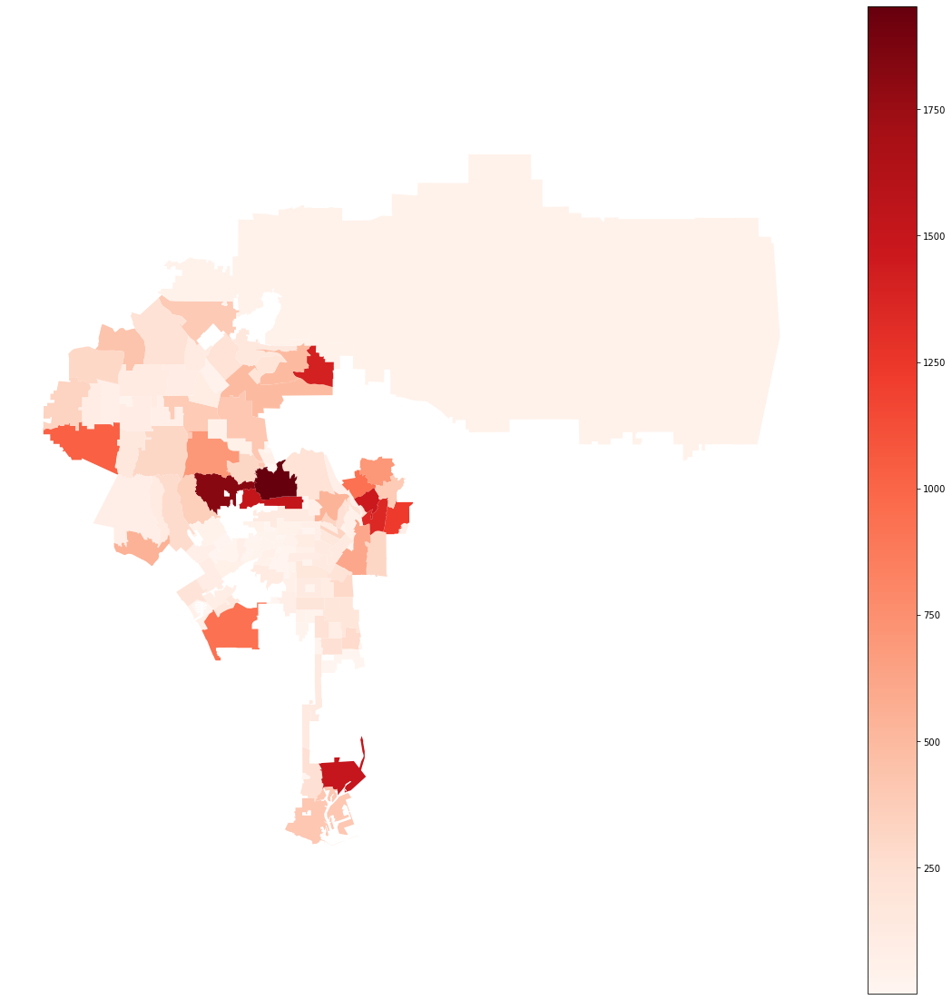

In [23]:
# choropleth map of vacant lots by community boundary
fig,ax = plt.subplots(figsize=(20,20))

ax.axis('off')

comgdf.plot(ax=ax,column='vac_count',legend=True,cmap='Reds')

We see the most neighborhoods with vacant lots are in far south, east and northeast LA. There is a dense area in the center which can be Elysian Park which is a large area of open space. And underneart which can be chinatown or downtown.

In [25]:
comgdf_la=comgdf[comgdf["city_type"] == "City"]

In [26]:
# project to web mercator 
comgdf_la = comgdf_la.to_crs(epsg=4326)

In [27]:
import folium

In [30]:
comgdf_la.head ()

,community,source,label,city_type,objectid,lcity,shape_stlength,shape_starea,geometry,vac_count
0,None,BOS,City of Agoura Hills,City,1,Agoura Hills,80374.083443170195,217940117.12695313,"MULTIPOLYGON (((-118.72864 34.16793, -118.7286...",NaN
1,None,BOS,City of Temple City,City,214,Temple City,60506.140608433387,112232462.72851563,"MULTIPOLYGON (((-118.05659 34.11841, -118.0563...",NaN
2,Harvard Heights,LA City,Los Angeles - Harvard Heights,City,95,Los Angeles,21077.385705038188,20898421.74609375,"MULTIPOLYGON (((-118.29156 34.04000, -118.2923...",55.0
4,Beverly Crest,LA City,Los Angeles - Beverly Crest,City,55,Los Angeles,110820.54850926602,234233281.15039063,"MULTIPOLYGON (((-118.40751 34.12945, -118.4074...",1818.0
5,None,BOS,City of Glendora,City,28,Glendora,165505.6706541336,547642777.50488281,"MULTIPOLYGON (((-117.79386 34.16515, -117.7977...",NaN


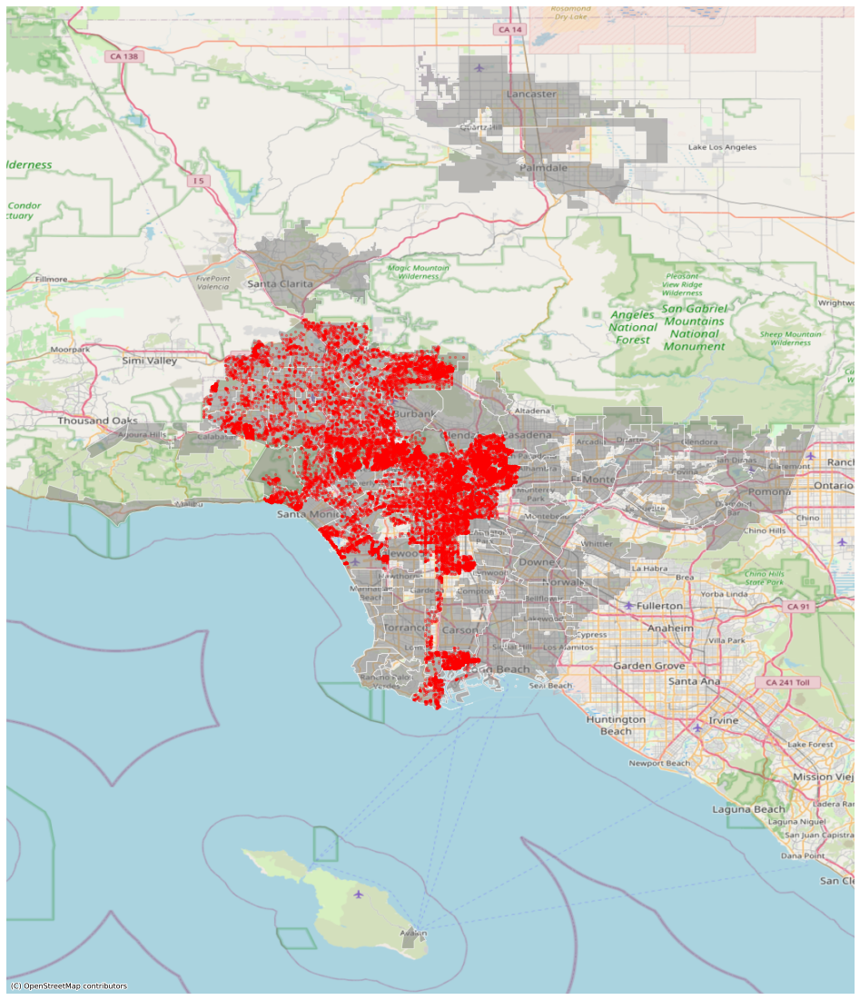

In [ ]:
# choropleth map of vacant lots by neighborhoods

# set up the plot canvas with plt.subplots
fig, ax = plt.subplots(figsize=(20, 20))

# block groups
comgdf_la.plot(ax=ax, # this puts it in the ax plot
        color='gray', 
        edgecolor='white',
        alpha=0.5)

# properties built in Inglewood between 1950-2020
vacgdf.plot(ax=ax, # this also puts it in the same ax plot
            color='red',
            markersize=5,
            alpha=0.3)

# no axis
ax.axis('off')

# add a basemap

ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik, crs=vacgdf_web_mercator.crs)

ooo now we got the vacant lots plotted within community boundaries, which is what we inititally wanted. Our interes is in East LA given the established efforts to adopt empty lots. We will try to zoom unto the number of vacant lots and the type of use.

## New Dataframe with scope into East and North East LA including Chinatown, East Hollywood and Westlake
A suggestion from our peers was to maybe compare to another area in LA. Given the large change of demogrpahics in West and East LA. We will include incorporated West communities in Los Angeles City like West LA, Rancho Park, .  

In [40]:
comgdf[comgdf.community == 'El Sereno']

,community,source,label,city_type,objectid,lcity,shape_stlength,shape_starea,geometry,vac_count
116,El Sereno,LA City,Los Angeles - El Sereno,City,78,Los Angeles,57287.733092284157,109050969.50683594,"MULTIPOLYGON (((-118.15536 34.09867, -118.1553...",1229.0


In [41]:
comgdf[comgdf.community == 'Chinatown']

,community,source,label,city_type,objectid,lcity,shape_stlength,shape_starea,geometry,vac_count
123,Chinatown,LA City,Los Angeles - Chinatown,City,68,Los Angeles,14754.461110663206,11187362.533203125,"MULTIPOLYGON (((-118.23789 34.05411, -118.2380...",68.0


In [42]:
comgdf[comgdf.community == 'Lincoln Heights']

,community,source,label,city_type,objectid,lcity,shape_stlength,shape_starea,geometry,vac_count
152,Lincoln Heights,LA City,Los Angeles - Lincoln Heights,City,108,Los Angeles,60756.009942239587,91056715.407226563,"MULTIPOLYGON (((-118.19006 34.09722, -118.1903...",1358.0


In [43]:
comgdf[comgdf.community == 'Echo Park']

,community,source,label,city_type,objectid,lcity,shape_stlength,shape_starea,geometry,vac_count
134,Echo Park,LA City,Los Angeles - Echo Park,City,77,Los Angeles,26540.216685480205,27755067.791992188,"MULTIPOLYGON (((-118.24619 34.08774, -118.2477...",236.0


In [44]:
comgdf[comgdf.community == 'Westlake']

,community,source,label,city_type,objectid,lcity,shape_stlength,shape_starea,geometry,vac_count
68,Westlake,LA City,Los Angeles - Westlake,City,178,Los Angeles,25486.343474060108,32043122.8515625,"MULTIPOLYGON (((-118.25590 34.05609, -118.2559...",150.0


In [47]:
comgdf[comgdf.community == 'East Hollywood']

,community,source,label,city_type,objectid,lcity,shape_stlength,shape_starea,geometry,vac_count
21,East Hollywood,LA City,Los Angeles - East Hollywood,City,76,Los Angeles,22876.428264011945,30724903.444335938,"MULTIPOLYGON (((-118.29171 34.08359, -118.2928...",75.0


In [46]:
comgdf[comgdf.community == 'Silverlake']

,community,source,label,city_type,objectid,lcity,shape_stlength,shape_starea,geometry,vac_count
262,Silverlake,LA City,Los Angeles - Silverlake,City,144,Los Angeles,64788.651872981274,106082837.66796875,"MULTIPOLYGON (((-118.24950 34.10840, -118.2495...",531.0


In [48]:
comgdf[comgdf.community == 'Angelino Heights']

,community,source,label,city_type,objectid,lcity,shape_stlength,shape_starea,geometry,vac_count
95,Angelino Heights,LA City,Los Angeles - Angelino Heights,City,50,Los Angeles,10403.789625798727,4179683.2294921875,"MULTIPOLYGON (((-118.24750 34.06368, -118.2476...",30.0


In [49]:
comgdf[comgdf.community == 'Baldwin Hills']

,community,source,label,city_type,objectid,lcity,shape_stlength,shape_starea,geometry,vac_count
228,Baldwin Hills,LA City,Los Angeles - Baldwin Hills,City,53,Los Angeles,51824.316008861198,72396942.770507813,"MULTIPOLYGON (((-118.35486 34.02551, -118.3550...",120.0


In [50]:
comgdf[comgdf.community == 'Crenshaw District']

,community,source,label,city_type,objectid,lcity,shape_stlength,shape_starea,geometry,vac_count
198,Crenshaw District,LA City,Los Angeles - Crenshaw District,City,71,Los Angeles,26081.474197359465,32980853.87109375,"MULTIPOLYGON (((-118.32998 34.03032, -118.3289...",16.0


In [51]:
com_new = comgdf.loc[[68,134,152,123,116, 21, 95, 262, 228, 198 ]]


In [52]:
com_new

,community,source,label,city_type,objectid,lcity,shape_stlength,shape_starea,geometry,vac_count
68,Westlake,LA City,Los Angeles - Westlake,City,178,Los Angeles,25486.343474060108,32043122.8515625,"MULTIPOLYGON (((-118.25590 34.05609, -118.2559...",150.0
134,Echo Park,LA City,Los Angeles - Echo Park,City,77,Los Angeles,26540.216685480205,27755067.791992188,"MULTIPOLYGON (((-118.24619 34.08774, -118.2477...",236.0
152,Lincoln Heights,LA City,Los Angeles - Lincoln Heights,City,108,Los Angeles,60756.009942239587,91056715.407226563,"MULTIPOLYGON (((-118.19006 34.09722, -118.1903...",1358.0
123,Chinatown,LA City,Los Angeles - Chinatown,City,68,Los Angeles,14754.461110663206,11187362.533203125,"MULTIPOLYGON (((-118.23789 34.05411, -118.2380...",68.0
116,El Sereno,LA City,Los Angeles - El Sereno,City,78,Los Angeles,57287.733092284157,109050969.50683594,"MULTIPOLYGON (((-118.15536 34.09867, -118.1553...",1229.0
21,East Hollywood,LA City,Los Angeles - East Hollywood,City,76,Los Angeles,22876.428264011945,30724903.444335938,"MULTIPOLYGON (((-118.29171 34.08359, -118.2928...",75.0
95,Angelino Heights,LA City,Los Angeles - Angelino Heights,City,50,Los Angeles,10403.789625798727,4179683.2294921875,"MULTIPOLYGON (((-118.24750 34.06368, -118.2476...",30.0
262,Silverlake,LA City,Los Angeles - Silverlake,City,144,Los Angeles,64788.651872981274,106082837.66796875,"MULTIPOLYGON (((-118.24950 34.10840, -118.2495...",531.0
228,Baldwin Hills,LA City,Los Angeles - Baldwin Hills,City,53,Los Angeles,51824.316008861198,72396942.770507813,"MULTIPOLYGON (((-118.35486 34.02551, -118.3550...",120.0
198,Crenshaw District,LA City,Los Angeles - Crenshaw District,City,71,Los Angeles,26081.474197359465,32980853.87109375,"MULTIPOLYGON (((-118.32998 34.03032, -118.3289...",16.0


In [53]:
com_new.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

### Now that I have the new dataframe with our focus area we will go ahead and join this with the vacant lots.

In [54]:
com_new_join = gpd.sjoin(vacgdf, com_new, how="inner", op="within")

In [55]:
com_new_join.head()

,usecodedescchar1,roll_homeownersexemp,situsunit,recordingdate,effectiveyearbuilt,istaxableparcel,roll_totlandimp,roll_perspropexemp,parcelboundarydescription,roll_landbaseyear,...,index_right,community,source,label,city_type,objectid,lcity,shape_stlength,shape_starea,vac_count
450,Residential,0,,19670245,0,Y,179,0,TRACT NO 13718 LOT 235,1975,...,228,Baldwin Hills,LA City,Los Angeles - Baldwin Hills,City,53,Los Angeles,51824.316008861198,72396942.770507813,120.0
451,Residential,0,,19490810,0,Y,179,0,TRACT NO 13718 LOT 236,1975,...,228,Baldwin Hills,LA City,Los Angeles - Baldwin Hills,City,53,Los Angeles,51824.316008861198,72396942.770507813,120.0
452,Residential,0,,19490810,0,Y,179,0,TRACT NO 13718 LOT 240,1975,...,228,Baldwin Hills,LA City,Los Angeles - Baldwin Hills,City,53,Los Angeles,51824.316008861198,72396942.770507813,120.0
453,Residential,0,,19670245,0,Y,179,0,TRACT NO 13718 LOT 230,1975,...,228,Baldwin Hills,LA City,Los Angeles - Baldwin Hills,City,53,Los Angeles,51824.316008861198,72396942.770507813,120.0
454,Residential,0,,19670245,0,Y,382,0,TRACT NO 13718 LOT 231,1975,...,228,Baldwin Hills,LA City,Los Angeles - Baldwin Hills,City,53,Los Angeles,51824.316008861198,72396942.770507813,120.0


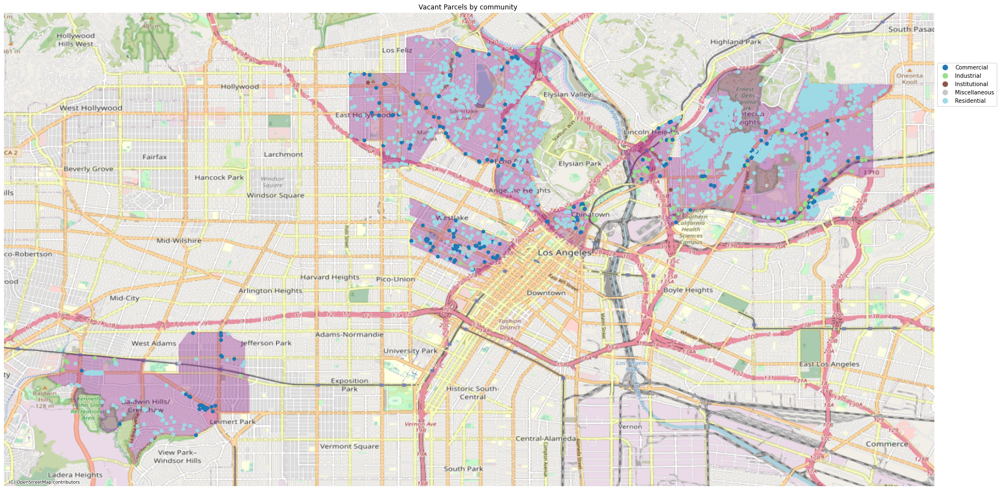

In [61]:
fig, ax = plt.subplots(figsize=(30,35))

com_new.plot(ax=ax,
                      color='purple',
                        alpha=0.3)

# create the map plot
com_new_join.plot(ax=ax,
         column='usecodedescchar1',
         cmap='tab20',
         legend=True,
         legend_kwds={'loc':'upper left','bbox_to_anchor':(1,.9)})

# add a title
ax.set_title('Vacant Parcels by community ')

# get rid of the axis
ax.axis('off');

ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik, crs=com_new_join.crs)

In [62]:
# convert lat/lon's to floats, as we saw the object type needs to be converted
com_new_join['center_lat'] = com_new_join['center_lat'].astype(float)
com_new_join['center_lon'] = com_new_join['center_lon'].astype(float)
com_new_join.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Int64Index: 3813 entries, 450 to 19187
Data columns (total 62 columns):
 #   Column                     Non-Null Count  Dtype   
---  ------                     --------------  -----   
 0   usecodedescchar1           3813 non-null   object  
 1   roll_homeownersexemp       3813 non-null   object  
 2   situsunit                  3813 non-null   object  
 3   recordingdate              3813 non-null   object  
 4   effectiveyearbuilt         3813 non-null   object  
 5   istaxableparcel            3813 non-null   object  
 6   roll_totlandimp            3813 non-null   object  
 7   roll_perspropexemp         3813 non-null   object  
 8   parcelboundarydescription  3813 non-null   object  
 9   roll_landbaseyear          3813 non-null   object  
 10  situscity                  3813 non-null   object  
 11  roll_impbaseyear           3813 non-null   object  
 12  usetype                    3813 non-null   object  
 13  cluster               

In [65]:
import matplotlib.pyplot as plt
# for interactive plots
import plotly.express as px

In [66]:
# important, we need to address null columns. we fill in any blank or null with "N/A"

com_new_join = com_new_join.fillna({'usecodedescchar1':'N/A'})

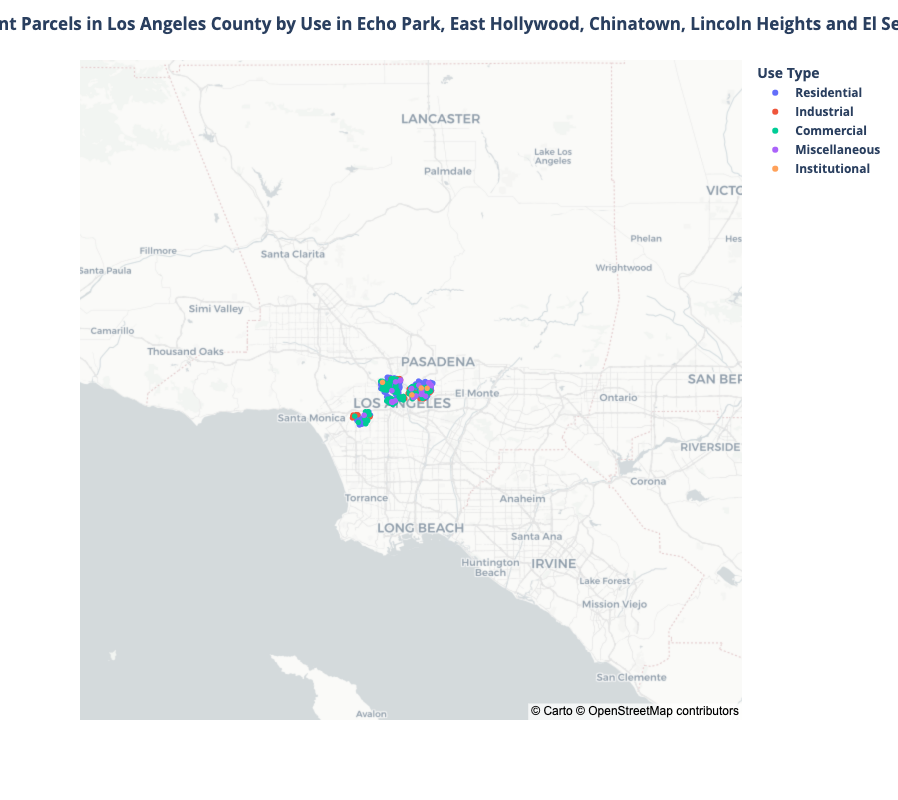

In [67]:
# what will se see next, perhaps type of parcels???
fig = px.scatter_mapbox(com_new_join, 
                        lat="center_lat", 
                        lon="center_lon", 
                        color="usecodedescchar1",
                        labels={'usecodedescchar1':'Use Type'},
                        mapbox_style="carto-positron"
                       )

# options on the layout
fig.update_layout(
    width = 800,
    height = 800,
    title = "Vacant Parcels in Los Angeles County by Use in Echo Park, East Hollywood, Chinatown, Lincoln Heights and El Sereno",
    title_x=0.5 # aligns title to center
)


fig.show()

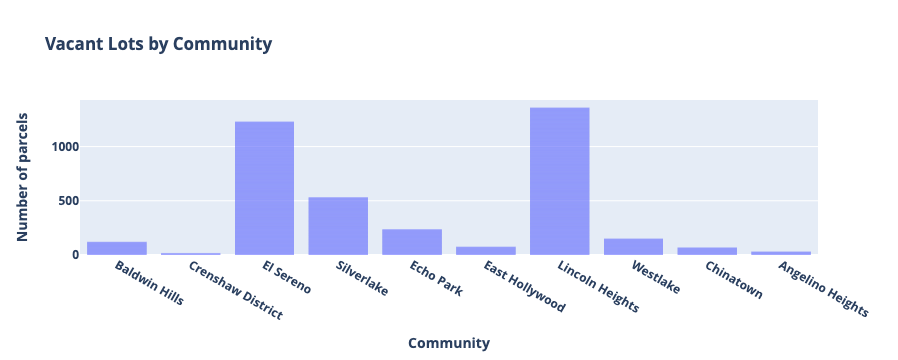

In [68]:
# add labels by providing a dict
fig = px.bar(
        com_new_join,
       x='community',
       title='Vacant Lots by Community',
        labels={
            'community':'Community',
            'count':'Number of parcels'
        }
)

# get rid of white lines inside the bars
fig.update_traces(marker_line_width=0)

# show the figure
fig.show()

Communities in East LA are more likely to have vacant lots designated for residential development. The more west we go the less vacant lots there are.

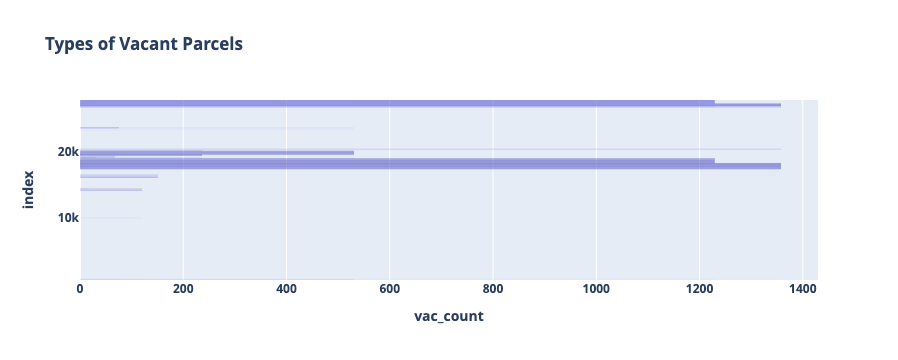

In [70]:
# add labels by providing a dict
fig = px.bar(
        com_new_join,
       x='vac_count',
       title='Types of Vacant Parcels ',
        labels={
            'usecodedescchar1':'Use Type',
            'count':'Number of parcels'
        }
)

# get rid of white lines inside the bars
fig.update_traces(marker_line_width=0)

# show the figure
fig.show()

In [154]:
import folium

In [156]:
m = folium.Map(
    location=[34.0536909, -118.242766],
    tiles="cartodbpositron",
    zoom_start=11,
)

m

In [157]:
comgdf_la. head ()

,community,source,label,city_type,objectid,lcity,shape_stlength,shape_starea,geometry,vac_count
0,None,BOS,City of Agoura Hills,City,1,Agoura Hills,80374.083443170195,217940117.12695313,"MULTIPOLYGON (((-118.72864 34.16793, -118.7286...",NaN
1,None,BOS,City of Temple City,City,214,Temple City,60506.140608433387,112232462.72851563,"MULTIPOLYGON (((-118.05659 34.11841, -118.0563...",NaN
2,Harvard Heights,LA City,Los Angeles - Harvard Heights,City,95,Los Angeles,21077.385705038188,20898421.74609375,"MULTIPOLYGON (((-118.29156 34.04000, -118.2923...",55.0
4,Beverly Crest,LA City,Los Angeles - Beverly Crest,City,55,Los Angeles,110820.54850926602,234233281.15039063,"MULTIPOLYGON (((-118.40751 34.12945, -118.4074...",1818.0
5,None,BOS,City of Glendora,City,28,Glendora,165505.6706541336,547642777.50488281,"MULTIPOLYGON (((-117.79386 34.16515, -117.7977...",NaN


In [160]:
folium.GeoJson(com_new_join, name="geojson").add_to(m)

m